In [1]:
%load_ext autoreload
%autoreload 2

import sys
import os
import time

import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

sys.path.append(os.path.join(os.environ['REPO_DIR'], 'utilities'))
from utilities2015 import *
from registration_utilities import *
from annotation_utilities import *
from metadata import *
from data_manager import *

/usr/local/lib/python2.7/dist-packages/matplotlib/__init__.py:1357: UserWarning:  This call to matplotlib.use() has no effect
because the backend has already been chosen;
matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


Setting environment for Local Macbook Pro


In [2]:
stack_fixed = 'MD593'
stack_moving = 'atlasV5'
detector_id = 15

In [3]:
volume_fixed, structure_to_label_fixed, label_to_structure_fixed = \
DataManager.load_original_volume_all_known_structures(stack=stack_fixed, prep_id=2, detector_id=detector_id, 
                                                      sided=False, volume_type='score')

Prior structure/index map not found. Generating a new one.
Volume shape: (383, 534, 374)


In [4]:
gradient_filepath_map_f = {ind_f: \
                           DataManager.get_volume_gradient_filepath_template(\
                            stack=stack_fixed, structure=struct_f, prep_id=2, detector_id=detector_id)
                           for ind_f, struct_f in label_to_structure_fixed.iteritems()}

In [5]:
registration_settings = read_csv(REGISTRATION_SETTINGS_CSV, header=0, index_col=0)
registration_settings

,upstream_warp_id,transform_type,terminate_thresh,grad_computation_sample_number,grid_search_sample_number,std_tx_um,std_ty_um,std_tz_um,std_theta_xy_degree,surround_weight,regularization_weight,comment,max_iter_num
warp_id,,,,,,,,,,,,,
1,None,affine,0.000010,100000.0,1000.0,2000.0,2000.0,2000.0,30.0,0,NaN,NaN,NaN
2,1,rigid,0.000010,100000.0,10000.0,100.0,100.0,100.0,30.0,0,NaN,NaN,NaN
4,1,rigid,0.000001,100000.0,10000.0,100.0,100.0,100.0,10.0,0,0.000001,NaN,NaN
5,1,rigid,0.000001,100000.0,10000.0,100.0,100.0,100.0,30.0,inverse,0.000000,NaN,NaN
6,1,affine,0.000010,100000.0,10000.0,100.0,100.0,100.0,30.0,-0.5,0.000000,NaN,NaN
7,None,rigid,0.000001,100000.0,1000.0,50.0,50.0,50.0,10.0,0,NaN,NaN,NaN
8,None,rigid,0.000001,100000.0,10000.0,200.0,200.0,200.0,30.0,inverse,0.000000,align mid-sagittal planes,NaN
9,8,rigid,0.000001,100000.0,10000.0,2000.0,2000.0,2000.0,30.0,NaN,NaN,global registration given mid-sagittal planes ...,NaN
10,None,rigid,0.000010,100000.0,1000.0,100.0,100.0,100.0,30.0,0,NaN,NaN,NaN


In [6]:
warp_setting = 17

In [7]:
warp_properties = registration_settings.loc[warp_setting]
print warp_properties

upstream_warp_setting = warp_properties['upstream_warp_id']
if upstream_warp_setting == 'None':
    upstream_warp_setting = None
else:
    upstream_warp_setting = int(upstream_warp_setting)
    
transform_type = warp_properties['transform_type']
terminate_thresh = warp_properties['terminate_thresh']
grad_computation_sample_number = int(warp_properties['grad_computation_sample_number'])
if not np.isnan(warp_properties['grid_search_sample_number']):
    grid_search_sample_number = int(warp_properties['grid_search_sample_number'])
if not np.isnan(warp_properties['std_tx_um']):
    std_tx_um = warp_properties['std_tx_um']
    std_tx = std_tx_um/(XY_PIXEL_DISTANCE_LOSSLESS*32)
if not np.isnan(warp_properties['std_ty_um']):
    std_ty_um = warp_properties['std_ty_um']
    std_ty = std_ty_um/(XY_PIXEL_DISTANCE_LOSSLESS*32)
if not np.isnan(warp_properties['std_tz_um']):
    std_tz_um = warp_properties['std_tz_um']
    std_tz = std_tz_um/(XY_PIXEL_DISTANCE_LOSSLESS*32)
if not np.isnan(warp_properties['std_theta_xy_degree']):
    std_theta_xy = np.deg2rad(warp_properties['std_theta_xy_degree'])
if not np.isnan(warp_properties['max_iter_num']):
    max_iter_num = int(warp_properties['max_iter_num'])
    
try:
    surround_weight = float(warp_properties['surround_weight'])
    include_surround = surround_weight != 0 and not np.isnan(surround_weight)
except:
    surround_weight = str(warp_properties['surround_weight'])
    include_surround = True

reg_weight = warp_properties['regularization_weight']
# if np.isnan(reg_weight):
#     reg_weights = np.zeros((3,))
# else:
#     reg_weights = np.ones((3,))*reg_weight
reg_weight = int(reg_weight)

print
print 'surround', surround_weight
# print 'regularization', reg_weights
print 'regularization', reg_weight

upstream_warp_id                                                  20
transform_type                                                 rigid
terminate_thresh                                                 NaN
grad_computation_sample_number                                 10000
grid_search_sample_number                                        NaN
std_tx_um                                                        NaN
std_ty_um                                                        NaN
std_tz_um                                                        NaN
std_theta_xy_degree                                              NaN
surround_weight                                              inverse
regularization_weight                                              0
comment                           local reg with surr no grid search
max_iter_num                                                    1000
Name: 17, dtype: object

surround inverse
regularization 0


In [8]:
positive_weight = 'size'

In [9]:
# MAX_ITER_NUM = 10000
HISTORY_LEN = 200
# MAX_GRID_SEARCH_ITER_NUM = 30

In [10]:
lr1 = 10
lr2 = 0.1

# General Align Code

In [11]:
from registration_utilities import *

In [12]:
structure = 'PBG_R'
# structure = 'SNC_R'
# structure = '3N_R'

In [13]:
if include_surround:
    volume_moving = DataManager.load_transformed_volume_all_known_structures(stack_m=stack_moving, 
                                 stack_f=stack_fixed, prep_id_f=2, detector_id_f=detector_id, warp_setting=upstream_warp_setting, 
                                structures=[structure, convert_to_surround_name(structure, margin='200')])
    
else:
    volume_moving = DataManager.load_transformed_volume_all_known_structures(stack_m=stack_moving, 
                                                                             stack_f=stack_fixed,
                                                                             prep_id_f=2, 
                                                                 detector_id_f=detector_id,
                                                                 warp_setting=upstream_warp_setting, 
                                                                 structures=[structure])

structure_to_label_moving = {s: l+1 for l, s in enumerate(sorted(volume_moving.keys()))}
label_to_structure_moving = {l+1: s for l, s in enumerate(sorted(volume_moving.keys()))}
volume_moving = {structure_to_label_moving[s]: v for s, v in volume_moving.items()}

label_mapping_m2f = {label_m: structure_to_label_fixed[convert_to_original_name(name_m)] 
                     for label_m, name_m in label_to_structure_moving.iteritems()}

if include_surround:

    inv_covar_mats_all_indices = {structure_to_label_moving[s]:
    np.linalg.inv(DataManager.load_prior_covariance_matrix(atlas_name=stack_moving, structure=convert_to_nonsurround_label(s)))
    for s in [structure, convert_to_surround_name(structure, margin='200')]}
else:
    inv_covar_mats_all_indices = {structure_to_label_moving[s] :
        np.linalg.inv(DataManager.load_prior_covariance_matrix(atlas_name=stack_moving, structure=convert_to_nonsurround_label(s)))
        for s in [structure]}
    

######################

cutoff = .5 # Structure size is defined as the number of voxels whose value is above this cutoff probability.
# volume_moving_structure_sizes = {m_ind: np.count_nonzero(volume_moving[m_ind] > cutoff) 
#                                  for m_ind in label_mapping_m2f.iterkeys()}
pool = Pool(NUM_CORES)
volume_moving_structure_sizes = dict(zip(volume_moving.keys(), 
                                         pool.map(lambda l: np.count_nonzero(volume_moving[l] > cutoff), 
                                                  label_mapping_m2f.iterkeys())))
pool.close()
pool.join()

########################

label_weights_m = {}

for label_m in label_mapping_m2f.iterkeys():
    name_m = label_to_structure_moving[label_m]
    if not is_surround_label(name_m):
        if positive_weight == 'size':
            label_weights_m[label_m] = 1.
        elif positive_weight == 'inverse':
            p = np.percentile(volume_moving_structure_sizes.values(), 50)
            label_weights_m[label_m] =  np.minimum(p / volume_moving_structure_sizes[label_m], 1.)
        else:
            sys.stderr.write("positive_weight %s is not recognized. Using the default.\n" % positive_weight)
            
for label_m in label_mapping_m2f.iterkeys():
    name_m = label_to_structure_moving[label_m]
    if is_surround_label(name_m):
        label_ns = structure_to_label_moving[convert_to_nonsurround_name(name_m)]
        if surround_weight == 'inverse':
            label_weights_m[label_m] = - label_weights_m[label_ns] * volume_moving_structure_sizes[label_ns]/float(volume_moving_structure_sizes[label_m])
        elif isinstance(surround_weight, int) or isinstance(surround_weight, float):
            label_weights_m[label_m] = surround_weight
        else:
            sys.stderr.write("surround_weight %s is not recognized. Using the default.\n" % surround_weight)


aligner = Aligner4(volume_fixed, volume_moving, 
                   labelIndexMap_m2f=label_mapping_m2f)

aligner.set_centroid(centroid_m='structure_centroid', centroid_f='centroid_m', 
                     indices_m=[structure_to_label_moving[structure]])

# aligner.set_regularization_weights(reg_weights)
aligner.set_regularization_weights(reg_weight)
aligner.set_inverse_covar_mats_all_indices(inv_covar_mats_all_indices)
aligner.set_label_weights(label_weights_m)

Prior structure/index map not found. Generating a new one.
Label weights not set, default to 1 for all structures.
Regularization weights not set, default to 0.
centroid_m: [ 160.21901593  182.91746672  317.6743945 ], centroid_f: [ 160.21901593  182.91746672  317.6743945 ]


In [174]:
# grid_search_T, grid_search_score = aligner.do_grid_search(grid_search_iteration_number=MAX_GRID_SEARCH_ITER_NUM, 
#                grid_search_sample_number=8,
#               std_tx=std_tx, std_ty=std_ty, std_tz=std_tz, std_theta_xy=0,
#                grid_search_eta=3., stop_radius_voxel=3)

In [175]:
# # Show the score landscape.

# max_pooling_radius_um = 2000
# xy_pixel_distance = XY_PIXEL_DISTANCE_LOSSLESS * 32
# max_pooling_radius_pixel = std_ty_um/xy_pixel_distance

# grid_size_um = 200
# grid_size_pixel = grid_size_um / xy_pixel_distance

# ###################

# dxs = np.arange(-max_pooling_radius_pixel, max_pooling_radius_pixel, grid_size_pixel)
# dys = np.arange(-max_pooling_radius_pixel, max_pooling_radius_pixel, grid_size_pixel)
# dzs = np.arange(-max_pooling_radius_pixel, max_pooling_radius_pixel, grid_size_pixel)
# # dxs = np.arange(20, 100, 10)
# # dys = np.arange(20, 100, 10)
# # dzs = np.arange(-30, 10, 5)
# neighbor_scores = aligner.compute_scores_neighborhood_grid(np.array([1,0,0,0,0,1,0,0,0,0,1,0]), 
#                                                            dxs=dxs, dys=dys, dzs=dzs,
#                                                            indices_m=label_mapping_m2f.keys())

# neighbor_scores = np.reshape(neighbor_scores, (len(dxs), len(dys), len(dzs)))

In [176]:
# for zi in range(0, len(dzs), 1):
# #     plt.figure();
#     plt.matshow(neighbor_scores[..., zi], cmap=plt.cm.jet, vmin=neighbor_scores.min(), vmax=neighbor_scores.max());
#     # plt.xticks(range(0, len(dxs), 10), ['%d' % (dxs[i] * xy_pixel_distance) for i in range(0, len(dxs), 10)]);
#     # plt.yticks(range(0, len(dys), 10), ['%d' % (dys[i] * xy_pixel_distance) for i in range(0, len(dys), 10)]);
#     plt.xticks(range(0, len(dxs), 3), ['%d' % dxs[i] for i in range(0, len(dxs), 3)]);
#     plt.yticks(range(0, len(dys), 3), ['%d' % dys[i] for i in range(0, len(dys), 3)]);
#     plt.colorbar();
#     # plt.ylabel('dx (um)');
#     # plt.xlabel('dy (um)');
#     plt.ylabel('dx (voxels)');
#     plt.xlabel('dy (voxels)');
#     plt.title('Registration Scores @ (dz=%d)' % dzs[zi]);
#     plt.gca().xaxis.set_ticks_position('bottom');
#     plt.show();

In [14]:
aligner.load_gradient(gradient_filepath_map_f=gradient_filepath_map_f) # 120s = 2 mins
# aligner.load_gradient(gradients=gradients) # 120s = 2 mins

indices_f: set([15])
load gradient 15: 9.814831 seconds
overall: 9.814930 seconds


In [15]:
trial_num = 1

T_all_trials = []
scores_all_trials = []
traj_all_trials = []

for trial_idx in range(trial_num):

    T, scores = aligner.optimize(tf_type=transform_type, 
                                 max_iter_num=max_iter_num, 
#                                  max_iter_num=2000, 
                                 history_len=HISTORY_LEN, 
#                                  terminate_thresh=1e-5,
                                 grad_computation_sample_number=grad_computation_sample_number,
                                 terminate_thresh_rot=.002,
                                 terminate_thresh_trans=.5,
#                                  lr1=1, lr2=1e-2,)
                                lr1=10, lr2=1e-2)
#                                 reg_weights=0.1)
#                                  init_T=grid_search_T)

#         print T.reshape((3,4))
#         plt.figure();
#         plt.plot(scores);
#         plt.show();
#         print max(scores), scores[-1]

    T = aligner.Ts[-1]

    T_all_trials.append(T)
    scores_all_trials.append(scores)
    traj_all_trials.append(np.array(aligner.Ts))


iteration 0
Norm of gradient = 2.449490
around x=0.58; around y=-0.57; around z=-0.58
step: 0.02 seconds
current score: -0.009710
new_T: [  9.89966914 -10.09966407   9.99933334]
det: 1.00

iteration 1
Norm of gradient = 1.967087
around x=0.47; around y=-0.05; around z=-1.11
step: 0.02 seconds
current score: -0.009625
new_T: [ 19.11740042 -19.65007604   3.84022534]
det: 1.00

iteration 2
Norm of gradient = 1.564817
around x=0.90; around y=-0.50; around z=-0.83
step: 0.02 seconds
current score: -0.009660
new_T: [ 12.87869459 -17.86646186  11.51329384]
det: 1.00

iteration 3
Norm of gradient = 1.008102
around x=0.77; around y=-0.28; around z=-1.05
step: 0.02 seconds
current score: -0.009614
new_T: [ 14.12494725 -24.56352742   7.03250779]
det: 1.00

iteration 4
Norm of gradient = 0.792656
around x=0.96; around y=-0.47; around z=-0.86
step: 0.02 seconds
current score: -0.009587
new_T: [ 12.094993   -21.19602427  10.80618737]
det: 1.00

iteration 5
Norm of gradient = 0.488657
around x=0.94;

Norm of gradient = 0.380436
around x=1.25; around y=0.03; around z=0.33
step: 0.02 seconds
current score: -0.009558
new_T: [ 12.50388223 -15.86317387   6.94642481]
det: 1.00

iteration 46
Norm of gradient = 0.374892
around x=1.17; around y=0.13; around z=0.30
step: 0.02 seconds
current score: -0.009555
new_T: [ 14.94624032 -14.27935446   6.3231253 ]
det: 1.00

iteration 47
Norm of gradient = 0.528038
around x=1.32; around y=-0.00; around z=0.39
step: 0.02 seconds
current score: -0.009562
new_T: [ 12.18313486 -16.03983907   7.76371111]
det: 1.00

iteration 48
Norm of gradient = 0.401264
around x=1.28; around y=0.09; around z=0.30
step: 0.02 seconds
current score: -0.009568
new_T: [ 15.11010523 -14.62845667   7.5647942 ]
det: 1.00

iteration 49
Norm of gradient = 0.383596
around x=1.31; around y=0.03; around z=0.44
step: 0.02 seconds
current score: -0.009566
new_T: [ 12.45096345 -15.49397941   7.41513844]
det: 1.00

iteration 50
Norm of gradient = 0.134677
around x=1.34; around y=0.04; a

Norm of gradient = 0.224630
around x=1.73; around y=0.34; around z=1.07
step: 0.02 seconds
current score: -0.009547
new_T: [ 14.16881133 -16.84484436   6.89487138]
det: 1.00

iteration 92
Norm of gradient = 0.253655
around x=1.78; around y=0.29; around z=1.12
step: 0.02 seconds
current score: -0.009544
new_T: [ 14.32125058 -15.58136211   8.32624458]
det: 1.00

iteration 93
Norm of gradient = 0.158113
around x=1.76; around y=0.32; around z=1.15
step: 0.02 seconds
current score: -0.009544
new_T: [ 13.64164664 -16.26594663   7.35901251]
det: 1.00

iteration 94
Norm of gradient = 0.168132
around x=1.79; around y=0.35; around z=1.09
step: 0.02 seconds
current score: -0.009550
new_T: [ 14.31727616 -17.17407226   7.18702009]
det: 1.00

iteration 95
Norm of gradient = 0.174528
around x=1.84; around y=0.31; around z=1.12
step: 0.02 seconds
current score: -0.009558
new_T: [ 14.52474392 -16.74022549   8.27368015]
det: 1.00

iteration 96
Norm of gradient = 0.177264
around x=1.83; around y=0.30; ar

Norm of gradient = 0.232454
around x=2.21; around y=0.46; around z=1.73
step: 0.02 seconds
current score: -0.009548
new_T: [ 14.0214941  -18.03734989   8.487964  ]
det: 1.00

iteration 137
Norm of gradient = 0.135206
around x=2.19; around y=0.50; around z=1.72
step: 0.02 seconds
current score: -0.009533
new_T: [ 14.93648122 -17.39081007   8.3633842 ]
det: 1.00

iteration 138
Norm of gradient = 0.218162
around x=2.20; around y=0.48; around z=1.76
step: 0.02 seconds
current score: -0.009543
new_T: [ 13.4380568  -18.58623134   7.8068953 ]
det: 1.00

iteration 139
Norm of gradient = 0.196410
around x=2.25; around y=0.44; around z=1.81
step: 0.02 seconds
current score: -0.009550
new_T: [ 13.44997402 -17.64892978   8.91354738]
det: 1.00

iteration 140
Norm of gradient = 0.227691
around x=2.19; around y=0.51; around z=1.79
step: 0.02 seconds
current score: -0.009549
new_T: [ 14.52729657 -17.00958901   8.08689851]
det: 1.00

iteration 141
Norm of gradient = 0.092354
around x=2.18; around y=0.5

Norm of gradient = 0.177854
around x=2.45; around y=0.71; around z=2.47
step: 0.02 seconds
current score: -0.009542
new_T: [ 13.68920962 -15.97488457   7.49666249]
det: 1.00

iteration 184
Norm of gradient = 0.225615
around x=2.41; around y=0.71; around z=2.56
step: 0.02 seconds
current score: -0.009534
new_T: [ 13.39859801 -14.5401217    7.46991641]
det: 1.00

iteration 185
Norm of gradient = 0.261625
around x=2.48; around y=0.72; around z=2.47
step: 0.02 seconds
current score: -0.009544
new_T: [ 14.11981951 -16.11423752   7.66095791]
det: 1.00

iteration 186
Norm of gradient = 0.062659
around x=2.50; around y=0.71; around z=2.48
step: 0.02 seconds
current score: -0.009543
new_T: [ 13.87755996 -16.4696893    7.78498388]
det: 1.00

iteration 187
Norm of gradient = 0.155438
around x=2.52; around y=0.67; around z=2.54
step: 0.02 seconds
current score: -0.009538
new_T: [ 13.29316387 -16.01515805   8.28704946]
det: 1.00

iteration 188
Norm of gradient = 0.171060
around x=2.49; around y=0.7

Norm of gradient = 0.109675
around x=2.93; around y=0.85; around z=2.80
step: 0.02 seconds
current score: -0.009531
new_T: [ 14.1253443  -20.11743613   8.18088554]
det: 1.00

iteration 228
Norm of gradient = 0.066272
around x=2.93; around y=0.88; around z=2.79
step: 0.02 seconds
current score: -0.009537
new_T: [ 14.60423964 -20.04248875   8.07062511]
det: 1.00

iteration 229
Norm of gradient = 0.100594
around x=2.91; around y=0.90; around z=2.81
step: 0.02 seconds
current score: -0.009545
new_T: [ 14.9624572  -19.31551346   8.01859779]
det: 1.00

iteration 230
Norm of gradient = 0.164842
around x=2.96; around y=0.85; around z=2.84
step: 0.02 seconds
current score: -0.009546
new_T: [ 14.53964159 -19.4617278    8.81867951]
det: 1.00

iteration 231
Norm of gradient = 0.144713
around x=3.02; around y=0.84; around z=2.81
step: 0.02 seconds
current score: -0.009544
new_T: [ 15.0423977  -19.88219081   9.46740477]
det: 1.00

iteration 232
Norm of gradient = 0.099873
around x=3.01; around y=0.8

Norm of gradient = 0.242434
around x=3.27; around y=1.03; around z=3.21
step: 0.02 seconds
current score: -0.009534
new_T: [ 15.07429231 -19.81936494   8.82677984]
det: 1.00

iteration 272
Norm of gradient = 0.162253
around x=3.23; around y=1.04; around z=3.27
step: 0.02 seconds
current score: -0.009536
new_T: [ 14.70759469 -19.04216667   8.34103141]
det: 1.00

iteration 273
Norm of gradient = 0.131693
around x=3.22; around y=1.03; around z=3.33
step: 0.02 seconds
current score: -0.009544
new_T: [ 14.0359132  -18.6307232    8.23870333]
det: 1.00

iteration 274
Norm of gradient = 0.039741
around x=3.23; around y=1.04; around z=3.32
step: 0.02 seconds
current score: -0.009541
new_T: [ 14.16273416 -18.85987866   8.20135198]
det: 1.00

iteration 275
Norm of gradient = 0.190730
around x=3.28; around y=1.05; around z=3.26
step: 0.02 seconds
current score: -0.009544
new_T: [ 15.31341452 -19.18733138   8.77703586]
det: 1.00

iteration 276
Norm of gradient = 0.119995
around x=3.27; around y=1.0

Norm of gradient = 0.138154
around x=3.67; around y=1.20; around z=3.66
step: 0.02 seconds
current score: -0.009528
new_T: [ 14.27163069 -21.21024351   8.39244893]
det: 1.00

iteration 325
Norm of gradient = 0.189960
around x=3.71; around y=1.21; around z=3.61
step: 0.02 seconds
current score: -0.009524
new_T: [ 15.57467554 -20.817735     9.23843728]
det: 1.00

iteration 326
Norm of gradient = 0.143581
around x=3.74; around y=1.18; around z=3.63
step: 0.02 seconds
current score: -0.009533
new_T: [ 14.73735895 -21.67619332   9.27017315]
det: 1.00

iteration 327
Norm of gradient = 0.086721
around x=3.73; around y=1.21; around z=3.61
step: 0.02 seconds
current score: -0.009536
new_T: [ 15.01191303 -21.91098611   8.82553164]
det: 1.00

iteration 328
Norm of gradient = 0.157438
around x=3.71; around y=1.20; around z=3.68
step: 0.02 seconds
current score: -0.009538
new_T: [ 14.20993312 -21.48369633   8.59121293]
det: 1.00

iteration 329
Norm of gradient = 0.137403
around x=3.76; around y=1.1

Norm of gradient = 0.076670
around x=3.95; around y=1.33; around z=3.97
step: 0.02 seconds
current score: -0.009520
new_T: [ 14.97918839 -20.95823282   9.03055054]
det: 1.00

iteration 369
Norm of gradient = 0.128211
around x=3.92; around y=1.38; around z=3.96
step: 0.02 seconds
current score: -0.009532
new_T: [ 15.49424137 -20.84495285   8.43744318]
det: 1.00

iteration 370
Norm of gradient = 0.178884
around x=3.94; around y=1.33; around z=4.02
step: 0.02 seconds
current score: -0.009529
new_T: [ 14.53850068 -20.65743523   8.88627748]
det: 1.00

iteration 371
Norm of gradient = 0.095706
around x=3.97; around y=1.32; around z=4.01
step: 0.02 seconds
current score: -0.009524
new_T: [ 14.37102689 -21.40251445   8.92146697]
det: 1.00

iteration 372
Norm of gradient = 0.106464
around x=4.00; around y=1.34; around z=3.97
step: 0.02 seconds
current score: -0.009547
new_T: [ 14.92562576 -21.76483152   8.97503236]
det: 1.00

iteration 373
Norm of gradient = 0.177795
around x=3.96; around y=1.4

Norm of gradient = 0.082992
around x=4.23; around y=1.48; around z=4.31
step: 0.03 seconds
current score: -0.009522
new_T: [ 15.23021947 -21.10117242   9.10452894]
det: 1.00

iteration 419
Norm of gradient = 0.070768
around x=4.25; around y=1.47; around z=4.31
step: 0.02 seconds
current score: -0.009539
new_T: [ 14.95491754 -21.66970918   9.03289298]
det: 1.00

iteration 420
Norm of gradient = 0.136755
around x=4.30; around y=1.43; around z=4.30
step: 0.02 seconds
current score: -0.009529
new_T: [ 14.99073982 -21.82703772   9.82478898]
det: 1.00

iteration 421
Norm of gradient = 0.150319
around x=4.30; around y=1.47; around z=4.27
step: 0.02 seconds
current score: -0.009527
new_T: [ 14.95846714 -22.83715392   9.09523891]
det: 1.00

iteration 422
Norm of gradient = 0.093533
around x=4.27; around y=1.50; around z=4.29
step: 0.02 seconds
current score: -0.009537
new_T: [ 14.89561415 -22.67800649   8.54715162]
det: 1.00

iteration 423
Norm of gradient = 0.189449
around x=4.29; around y=1.4

Norm of gradient = 0.103501
around x=4.50; around y=1.57; around z=4.52
step: 0.04 seconds
current score: -0.009551
new_T: [ 15.70862953 -21.85858468   9.54167411]
det: 1.00

iteration 463
Norm of gradient = 0.024101
around x=4.50; around y=1.58; around z=4.52
step: 0.03 seconds
current score: -0.009507
new_T: [ 15.71788041 -21.98435875   9.46041732]
det: 1.00

iteration 464
Norm of gradient = 0.052499
around x=4.50; around y=1.59; around z=4.53
step: 0.03 seconds
current score: -0.009520
new_T: [ 15.467218   -22.22599563   9.14217253]
det: 1.00

iteration 465
Norm of gradient = 0.071235
around x=4.52; around y=1.58; around z=4.53
step: 0.04 seconds
current score: -0.009536
new_T: [ 15.13153016 -22.69284316   9.18850759]
det: 1.00

iteration 466
Norm of gradient = 0.109133
around x=4.49; around y=1.61; around z=4.55
step: 0.03 seconds
current score: -0.009532
new_T: [ 14.91496809 -22.63282276   8.52187145]
det: 1.00

iteration 467
Norm of gradient = 0.112762
around x=4.48; around y=1.6

Norm of gradient = 0.074015
around x=4.68; around y=1.70; around z=4.78
step: 0.03 seconds
current score: -0.009515
new_T: [ 16.06835252 -22.11148336   9.11946004]
det: 1.00

iteration 511
Norm of gradient = 0.066171
around x=4.70; around y=1.71; around z=4.77
step: 0.03 seconds
current score: -0.009536
new_T: [ 15.87387563 -22.64647074   8.94717338]
det: 1.00

iteration 512
Norm of gradient = 0.157377
around x=4.73; around y=1.66; around z=4.81
step: 0.03 seconds
current score: -0.009529
new_T: [ 15.514393   -22.36858205   9.79864347]
det: 1.00

iteration 513
Norm of gradient = 0.193328
around x=4.69; around y=1.73; around z=4.78
step: 0.03 seconds
current score: -0.009531
new_T: [ 16.08871614 -22.28647383   8.78962754]
det: 1.00

iteration 514
Norm of gradient = 0.082288
around x=4.67; around y=1.72; around z=4.82
step: 0.03 seconds
current score: -0.009511
new_T: [ 15.91359564 -21.78464536   8.80242148]
det: 1.00

iteration 515
Norm of gradient = 0.100704
around x=4.67; around y=1.7

Norm of gradient = 0.068155
around x=4.81; around y=1.81; around z=5.10
step: 0.02 seconds
current score: -0.009512
new_T: [ 16.11851059 -20.56586197   8.98606303]
det: 1.00

iteration 558
Norm of gradient = 0.117190
around x=4.80; around y=1.80; around z=5.13
step: 0.02 seconds
current score: -0.009549
new_T: [ 15.23336902 -20.89660447   8.62212916]
det: 1.00

iteration 559
Norm of gradient = 0.036619
around x=4.80; around y=1.81; around z=5.12
step: 0.02 seconds
current score: -0.009515
new_T: [ 15.31151708 -21.08668178   8.44606487]
det: 1.00

iteration 560
Norm of gradient = 0.157862
around x=4.84; around y=1.76; around z=5.16
step: 0.02 seconds
current score: -0.009526
new_T: [ 14.5995305  -21.11864846   9.06922314]
det: 1.00

iteration 561
Norm of gradient = 0.095594
around x=4.83; around y=1.80; around z=5.14
step: 0.02 seconds
current score: -0.009545
new_T: [ 15.02226287 -21.30110362   8.65920658]
det: 1.00

iteration 562
Norm of gradient = 0.111202
around x=4.87; around y=1.7

Norm of gradient = 0.161338
around x=5.01; around y=1.84; around z=5.39
step: 0.02 seconds
current score: -0.009526
new_T: [ 15.10300064 -20.69677805   9.499957  ]
det: 1.00

iteration 608
Norm of gradient = 0.066531
around x=4.99; around y=1.86; around z=5.39
step: 0.02 seconds
current score: -0.009503
new_T: [ 15.15144098 -20.50769028   9.1419074 ]
det: 1.00

iteration 609
Norm of gradient = 0.082178
around x=5.01; around y=1.86; around z=5.39
step: 0.02 seconds
current score: -0.009523
new_T: [ 14.8864394  -21.17868259   9.0876138 ]
det: 1.00

iteration 610
Norm of gradient = 0.068160
around x=5.01; around y=1.87; around z=5.38
step: 0.02 seconds
current score: -0.009526
new_T: [ 15.40422938 -20.82918569   9.21593677]
det: 1.00

iteration 611
Norm of gradient = 0.092799
around x=5.04; around y=1.86; around z=5.37
step: 0.02 seconds
current score: -0.009504
new_T: [ 15.77894102 -20.66090086   9.79270617]
det: 1.00

iteration 612
Norm of gradient = 0.071013
around x=5.02; around y=1.8

Norm of gradient = 0.086008
around x=5.20; around y=1.94; around z=5.52
step: 0.02 seconds
current score: -0.009537
new_T: [ 15.89428863 -21.56919635   9.45287933]
det: 1.00

iteration 657
Norm of gradient = 0.051457
around x=5.19; around y=1.96; around z=5.52
step: 0.02 seconds
current score: -0.009510
new_T: [ 15.87957586 -21.86038547   9.15242591]
det: 1.00

iteration 658
Norm of gradient = 0.031089
around x=5.21; around y=1.95; around z=5.52
step: 0.02 seconds
current score: -0.009520
new_T: [ 15.86270791 -22.00946313   9.27436541]
det: 1.00

iteration 659
Norm of gradient = 0.088312
around x=5.22; around y=1.96; around z=5.50
step: 0.02 seconds
current score: -0.009513
new_T: [ 15.82902606 -22.70753438   9.0633128 ]
det: 1.00

iteration 660
Norm of gradient = 0.134409
around x=5.25; around y=1.92; around z=5.52
step: 0.02 seconds
current score: -0.009530
new_T: [ 15.73884648 -22.34172554   9.87682054]
det: 1.00

iteration 661
Norm of gradient = 0.133068
around x=5.24; around y=1.9

Norm of gradient = 0.079337
around x=5.34; around y=2.04; around z=5.71
step: 0.02 seconds
current score: -0.009519
new_T: [ 15.69370999 -22.14669272   8.86993606]
det: 1.00

iteration 705
Norm of gradient = 0.122452
around x=5.32; around y=2.04; around z=5.75
step: 0.02 seconds
current score: -0.009542
new_T: [ 14.94441037 -22.08929233   8.4424543 ]
det: 1.00

iteration 706
Norm of gradient = 0.106779
around x=5.33; around y=2.02; around z=5.78
step: 0.02 seconds
current score: -0.009526
new_T: [ 15.084856   -21.40187411   9.00839398]
det: 1.00

iteration 707
Norm of gradient = 0.106802
around x=5.33; around y=2.04; around z=5.74
step: 0.02 seconds
current score: -0.009547
new_T: [ 15.81401827 -21.48455336   8.976369  ]
det: 1.00

iteration 708
Norm of gradient = 0.128930
around x=5.36; around y=2.01; around z=5.76
step: 0.02 seconds
current score: -0.009502
new_T: [ 15.06838506 -21.93036773   9.26602487]
det: 1.00

iteration 709
Norm of gradient = 0.067293
around x=5.35; around y=2.0

Norm of gradient = 0.080304
around x=5.44; around y=2.10; around z=5.94
step: 0.02 seconds
current score: -0.009534
new_T: [ 15.70609074 -21.44626205   9.05782269]
det: 1.00

iteration 755
Norm of gradient = 0.066066
around x=5.46; around y=2.08; around z=5.95
step: 0.02 seconds
current score: -0.009494
new_T: [ 15.41419634 -21.77763893   9.21468912]
det: 1.00

iteration 756
Norm of gradient = 0.034674
around x=5.45; around y=2.08; around z=5.96
step: 0.02 seconds
current score: -0.009520
new_T: [ 15.46745719 -21.51095457   9.28961424]
det: 1.00

iteration 757
Norm of gradient = 0.033533
around x=5.46; around y=2.08; around z=5.95
step: 0.02 seconds
current score: -0.009534
new_T: [ 15.52203902 -21.76125353   9.21378889]
det: 1.00

iteration 758
Norm of gradient = 0.038853
around x=5.47; around y=2.08; around z=5.95
step: 0.02 seconds
current score: -0.009518
new_T: [ 15.73662299 -21.53374221   9.40279323]
det: 1.00

iteration 759
Norm of gradient = 0.053393
around x=5.48; around y=2.0

Norm of gradient = 0.102172
around x=5.64; around y=2.12; around z=6.06
step: 0.03 seconds
current score: -0.009520
new_T: [ 16.1404237  -22.58829448   9.91015911]
det: 1.00

iteration 805
Norm of gradient = 0.048912
around x=5.65; around y=2.12; around z=6.05
step: 0.02 seconds
current score: -0.009526
new_T: [ 15.9715471  -22.98541058   9.84697434]
det: 1.00

iteration 806
Norm of gradient = 0.099400
around x=5.66; around y=2.14; around z=6.03
step: 0.02 seconds
current score: -0.009522
new_T: [ 16.16783633 -23.6322056    9.5138614 ]
det: 1.00

iteration 807
Norm of gradient = 0.055903
around x=5.66; around y=2.13; around z=6.05
step: 0.02 seconds
current score: -0.009511
new_T: [ 15.85451469 -23.51787844   9.60013035]
det: 1.00

iteration 808
Norm of gradient = 0.047178
around x=5.66; around y=2.12; around z=6.06
step: 0.02 seconds
current score: -0.009514
new_T: [ 15.86561512 -23.18083024   9.78703564]
det: 1.00

iteration 809
Norm of gradient = 0.019562
around x=5.66; around y=2.1

Norm of gradient = 0.044466
around x=5.72; around y=2.20; around z=6.28
step: 0.02 seconds
current score: -0.009529
new_T: [ 15.95319881 -22.21456432   9.37510615]
det: 1.00

iteration 858
Norm of gradient = 0.060407
around x=5.70; around y=2.21; around z=6.30
step: 0.02 seconds
current score: -0.009497
new_T: [ 15.81928266 -21.93208978   9.17608793]
det: 1.00

iteration 859
Norm of gradient = 0.065673
around x=5.72; around y=2.19; around z=6.31
step: 0.02 seconds
current score: -0.009522
new_T: [ 15.85917599 -21.74086622   9.59631348]
det: 1.00

iteration 860
Norm of gradient = 0.130111
around x=5.69; around y=2.24; around z=6.29
step: 0.02 seconds
current score: -0.009505
new_T: [ 16.31833705 -21.76126802   8.9449444 ]
det: 1.00

iteration 861
Norm of gradient = 0.098498
around x=5.72; around y=2.21; around z=6.29
step: 0.02 seconds
current score: -0.009541
new_T: [ 15.89708324 -22.21318696   9.23777363]
det: 1.00

iteration 862
Norm of gradient = 0.049802
around x=5.71; around y=2.2

Norm of gradient = 0.075776
around x=5.80; around y=2.23; around z=6.44
step: 0.02 seconds
current score: -0.009532
new_T: [ 15.48665728 -21.70973544   9.45674696]
det: 1.00

iteration 902
Norm of gradient = 0.024370
around x=5.81; around y=2.23; around z=6.44
step: 0.02 seconds
current score: -0.009519
new_T: [ 15.59466134 -21.62172942   9.60916228]
det: 1.00

iteration 903
Norm of gradient = 0.114760
around x=5.81; around y=2.25; around z=6.41
step: 0.02 seconds
current score: -0.009508
new_T: [ 15.94025774 -22.22990258   9.24239172]
det: 1.00

iteration 904
Norm of gradient = 0.061250
around x=5.79; around y=2.27; around z=6.42
step: 0.02 seconds
current score: -0.009502
new_T: [ 15.69666587 -22.28232351   8.87960507]
det: 1.00

iteration 905
Norm of gradient = 0.029200
around x=5.80; around y=2.26; around z=6.43
step: 0.02 seconds
current score: -0.009507
new_T: [ 15.59272118 -22.19082856   8.94945589]
det: 1.00

iteration 906
Norm of gradient = 0.048786
around x=5.80; around y=2.2

Norm of gradient = 0.053597
around x=5.91; around y=2.29; around z=6.53
step: 0.02 seconds
current score: -0.009519
new_T: [ 15.98041517 -22.67512902   9.38105932]
det: 1.00

iteration 953
Norm of gradient = 0.107847
around x=5.89; around y=2.33; around z=6.51
step: 0.02 seconds
current score: -0.009535
new_T: [ 16.62345441 -22.52877962   9.07492795]
det: 1.00

iteration 954
Norm of gradient = 0.105950
around x=5.90; around y=2.30; around z=6.55
step: 0.02 seconds
current score: -0.009517
new_T: [ 16.46127357 -22.01673892   9.56582803]
det: 1.00

iteration 955
Norm of gradient = 0.040478
around x=5.91; around y=2.30; around z=6.55
step: 0.02 seconds
current score: -0.009500
new_T: [ 16.17329098 -22.22140834   9.49772932]
det: 1.00

iteration 956
Norm of gradient = 0.055589
around x=5.91; around y=2.29; around z=6.56
step: 0.02 seconds
current score: -0.009526
new_T: [ 15.79587443 -22.5685185    9.38239989]
det: 1.00

iteration 957
Norm of gradient = 0.067923
around x=5.91; around y=2.2

In [ ]:
# params_fp = DataManager.get_alignment_result_filepath(stack_m=stack_moving, 
#                                                       stack_f=stack_fixed,
#                                                       detector_id_f=detector_id,
#                                                       prep_id_f=2,
#                                                       structure_f=structure,
#                                                       structure_m=structure,
#                                                       warp_setting=warp_setting,
#                                                      trial_idx=trial_idx, what='parameters')
# DataManager.save_alignment_parameters(params_fp, T, 
#                                       aligner.centroid_m, aligner.centroid_f,
#                                       aligner.xdim_m, aligner.ydim_m, aligner.zdim_m, 
#                                       aligner.xdim_f, aligner.ydim_f, aligner.zdim_f)
# upload_to_s3(params_fp)

# ##################################

# history_fp = DataManager.get_alignment_result_filepath(stack_m=stack_moving, 
#                                               stack_f=stack_fixed,
#                                               detector_id_f=detector_id,
#                                               prep_id_f=2,
#                                             structure_f=structure,
#                                             structure_m=structure,        
#                                               warp_setting=warp_setting,
#                                              trial_idx=trial_idx, what='scoreHistory')
# bp.pack_ndarray_file(np.array(scores), history_fp)
# upload_to_s3(history_fp)

# ##################################

# score_plot_fp = DataManager.get_alignment_result_filepath(stack_m=stack_moving, 
#                                               stack_f=stack_fixed,
#                                               detector_id_f=detector_id,
#                                               prep_id_f=2,
#                                             structure_f=structure,
#                                             structure_m=structure,
#                                               warp_setting=warp_setting,
#                                              trial_idx=trial_idx, what='scoreEvolution')
# fig = plt.figure();
# plt.plot(scores);
# plt.savefig(score_plot_fp, bbox_inches='tight')
# plt.close(fig)

# upload_to_s3(score_plot_fp)

# ##################################

# trajectory_fp = DataManager.get_alignment_result_filepath(stack_m=stack_moving, 
#                                               stack_f=stack_fixed,
#                                               detector_id_f=detector_id,
#                                               prep_id_f=2,
#                                             structure_f=structure,
#                                               structure_m=structure,
#                                               warp_setting=warp_setting,
#                                              trial_idx=trial_idx, what='trajectory')
# bp.pack_ndarray_file(np.array(aligner.Ts), trajectory_fp)
# upload_to_s3(trajectory_fp)


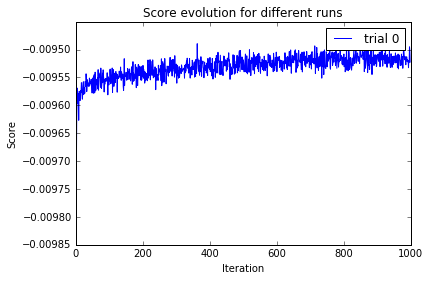

In [45]:
plt.figure();
for trial_idx, scores in enumerate(scores_all_trials):
    plt.plot(scores, label='trial ' + str(trial_idx));
plt.xlabel('Iteration');
plt.ylabel('Score');
plt.legend();
plt.title('Score evolution for different runs');

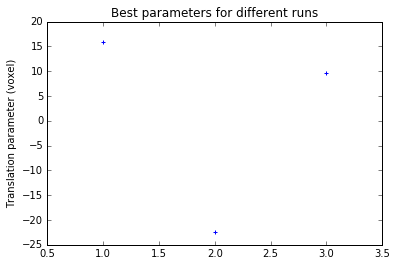

In [46]:
T_all_trials = np.array(T_all_trials)
plt.scatter(np.ones((T_all_trials.shape[0],)), T_all_trials[:, 3], marker='+');
plt.scatter(2*np.ones((T_all_trials.shape[0],)), T_all_trials[:, 7], marker='+');
plt.scatter(3*np.ones((T_all_trials.shape[0],)), T_all_trials[:, 11], marker='+');
plt.ylabel('Translation parameter (voxel)');
plt.title('Best parameters for different runs');

Best trial: 0
[[  0.99404088  -0.09744501   0.04885895  15.94309814]
 [  0.10217505   0.9890916   -0.10610406 -22.38651881]
 [ -0.03798667   0.11046394   0.99315393   9.58718754]]


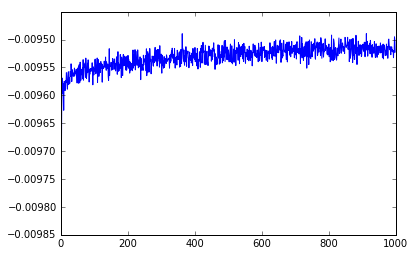

-0.00948948230333 -0.00952253309838


In [47]:
best_trial = np.argsort([np.max(scores) for scores in scores_all_trials])[-1]
# best_trial = 0
T = T_all_trials[best_trial]
scores = scores_all_trials[best_trial]
print 'Best trial:', best_trial
print T.reshape((3,4))
plt.figure();
plt.plot(scores);
plt.show();
print max(scores), scores[-1]

# Draw Results

In [48]:
t = time.time()

# local_params, centroid_m, centroid_f, xdim_m, ydim_m, zdim_m, xdim_f, ydim_f, zdim_f = \
# DataManager.load_alignment_parameters(stack_m=stack_moving, stack_f=stack_fixed,
#                                       classifier_setting_m=classifier_setting,
#                                       classifier_setting_f=classifier_setting,
#                                       warp_setting=warp_setting,
#                                       param_suffix=structure,
#                                       trial_idx=trial_idx)

local_params, centroid_m, centroid_f, xdim_m, ydim_m, zdim_m, xdim_f, ydim_f, zdim_f = \
(T, 
  aligner.centroid_m, aligner.centroid_f,
  aligner.xdim_m, aligner.ydim_m, aligner.zdim_m, 
  aligner.xdim_f, aligner.ydim_f, aligner.zdim_f)

# local_params, centroid_m, centroid_f, xdim_m, ydim_m, zdim_m, xdim_f, ydim_f, zdim_f = \
# ([1,0,0,0,0,1,0,0,0,0,1,0], 
#   aligner.centroid_m, aligner.centroid_f,
#   aligner.xdim_m, aligner.ydim_m, aligner.zdim_m, 
#   aligner.xdim_f, aligner.ydim_f, aligner.zdim_f)


# Read global tx
global_transformed_moving_structure_vol = \
DataManager.load_transformed_volume(stack_m=stack_moving, stack_f=stack_fixed,
                                    prep_id_f=2,
                                    detector_id_f=detector_id,
                                    warp_setting=upstream_warp_setting, 
                                    structure=structure)

# Transform
local_transformed_moving_structure_vol = transform_volume(vol=global_transformed_moving_structure_vol, 
                                         global_params=local_params, 
                                         centroid_m=centroid_m, centroid_f=centroid_f,
                                         xdim_f=xdim_f, ydim_f=ydim_f, zdim_f=zdim_f)

#         # Save
#         local_transformed_moving_structure_fn = \
#         DataManager.get_transformed_volume_filepath(stack_m=stack_moving, stack_f=stack_fixed,
#                                                     classifier_setting_m=classifier_setting,
#                                                     classifier_setting_f=classifier_setting,
#                                                     warp_setting=warp_setting,
#                                                     trial_idx=trial_idx,
#                                                     structure=structure)

#         create_if_not_exists(os.path.dirname(local_transformed_moving_structure_fn))
#         bp.pack_ndarray_file(local_transformed_moving_structure_vol, local_transformed_moving_structure_fn)

sys.stderr.write('Transform: %.2f seconds.\n' % (time.time() - t))

Transform: 3.55 seconds.


In [49]:
# Set colors for different contour level
levels = [0.1, 0.25, 0.5, 0.75, .99]
# levels = [0.5]
level_colors = {level: (int(level*255),0,0) for level in levels}

0 533 0 382 111 484
rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N63-2015.08.21-21.34.06_MD593_3_0189_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N63-2015.08.21-21.34.06_MD593_3_0189_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N63-2015.08.21-21.34.06_MD593_3_0189_prep2_down8_PBG_detector15_scoremapViz.jpg"


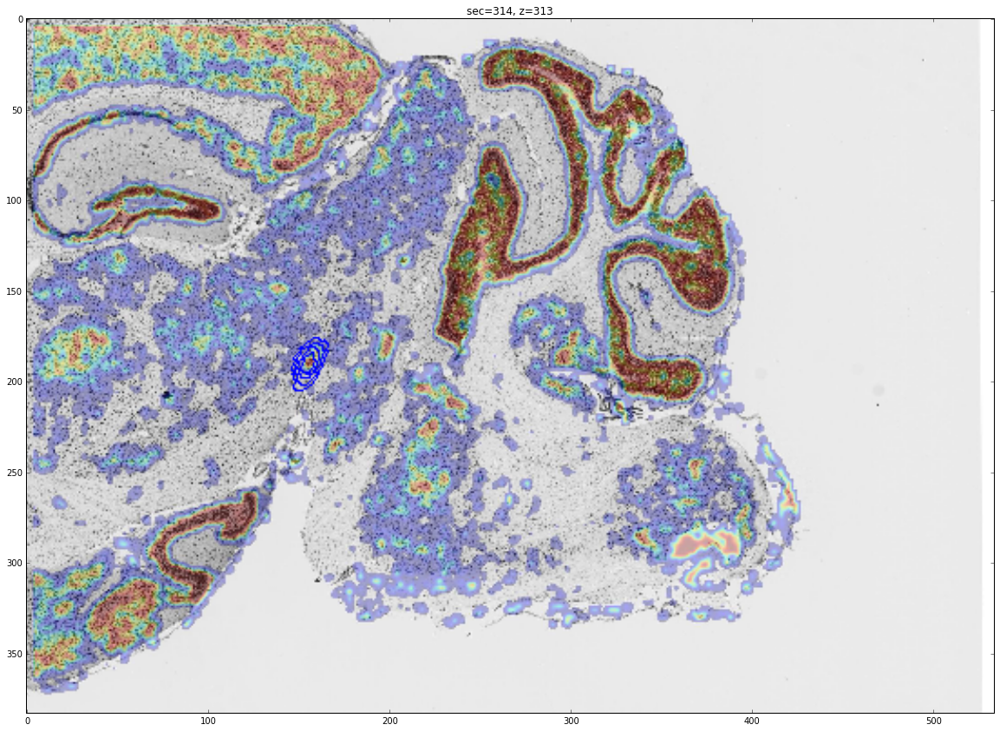

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC63-2015.08.25-18.25.27_MD593_1_0189_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC63-2015.08.25-18.25.27_MD593_1_0189_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC63-2015.08.25-18.25.27_MD593_1_0189_prep2_down8_PBG_detector15_scoremapViz.jpg"


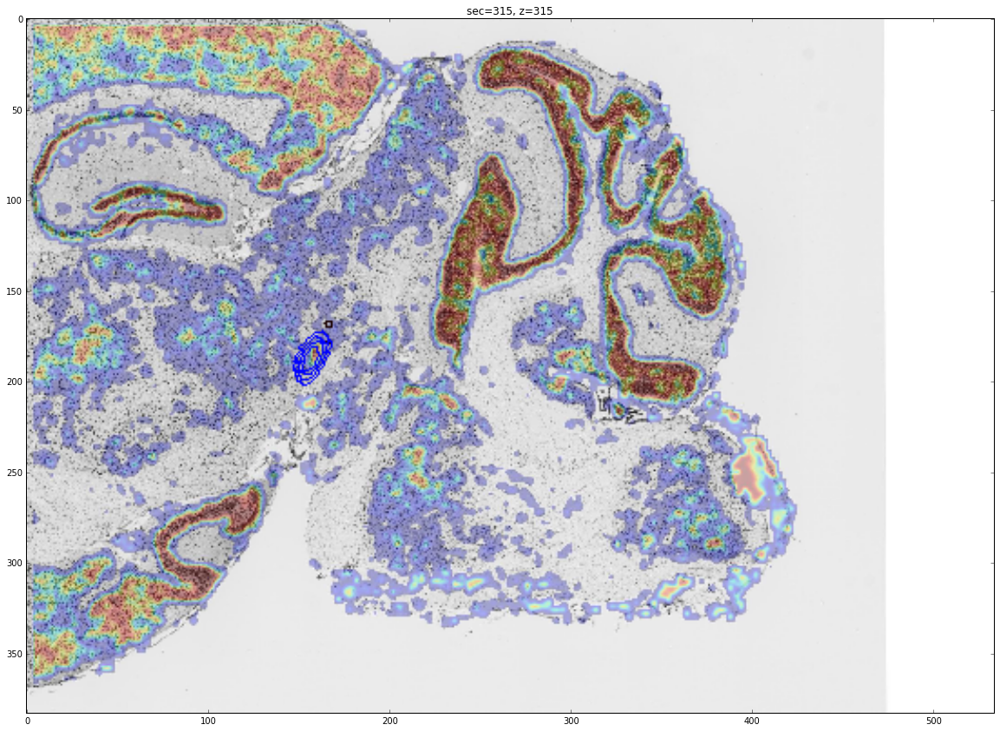

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N64-2015.08.21-21.38.56_MD593_1_0190_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N64-2015.08.21-21.38.56_MD593_1_0190_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N64-2015.08.21-21.38.56_MD593_1_0190_prep2_down8_PBG_detector15_scoremapViz.jpg"


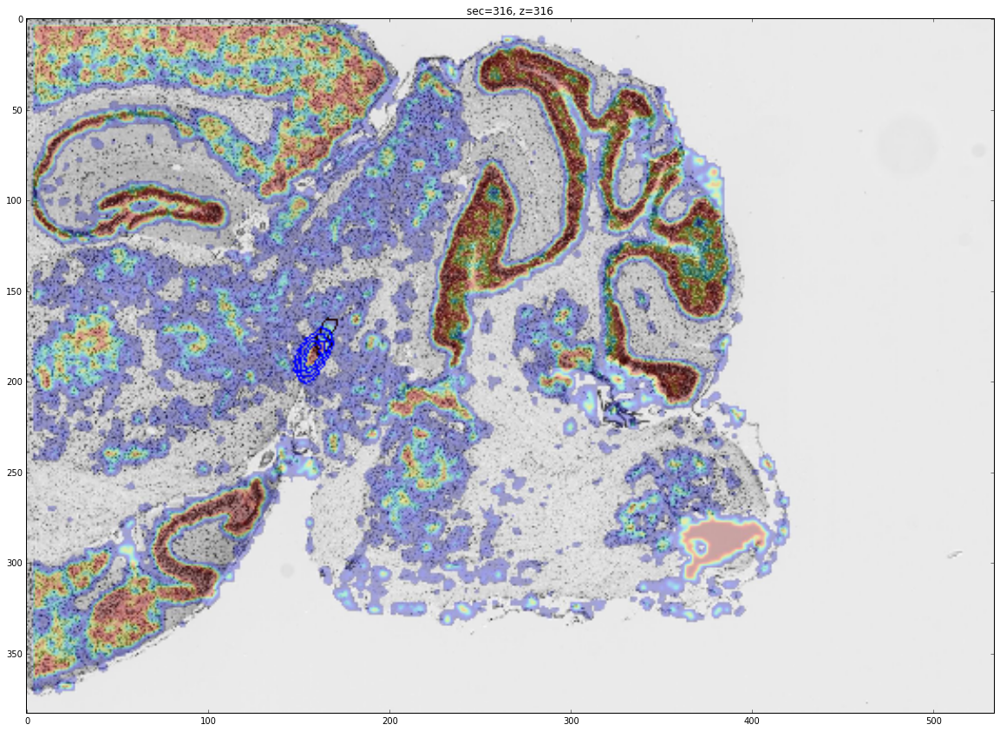

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC64-2015.08.25-18.30.40_MD593_3_0190_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC64-2015.08.25-18.30.40_MD593_3_0190_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC64-2015.08.25-18.30.40_MD593_3_0190_prep2_down8_PBG_detector15_scoremapViz.jpg"


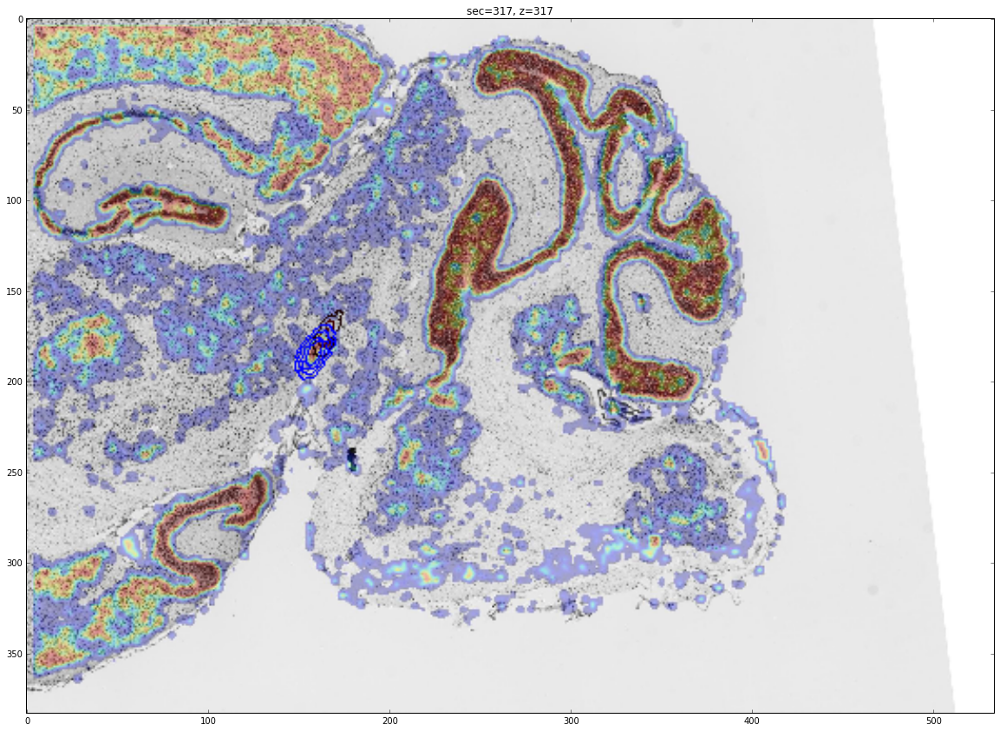

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N64-2015.08.21-21.38.56_MD593_2_0191_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N64-2015.08.21-21.38.56_MD593_2_0191_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N64-2015.08.21-21.38.56_MD593_2_0191_prep2_down8_PBG_detector15_scoremapViz.jpg"


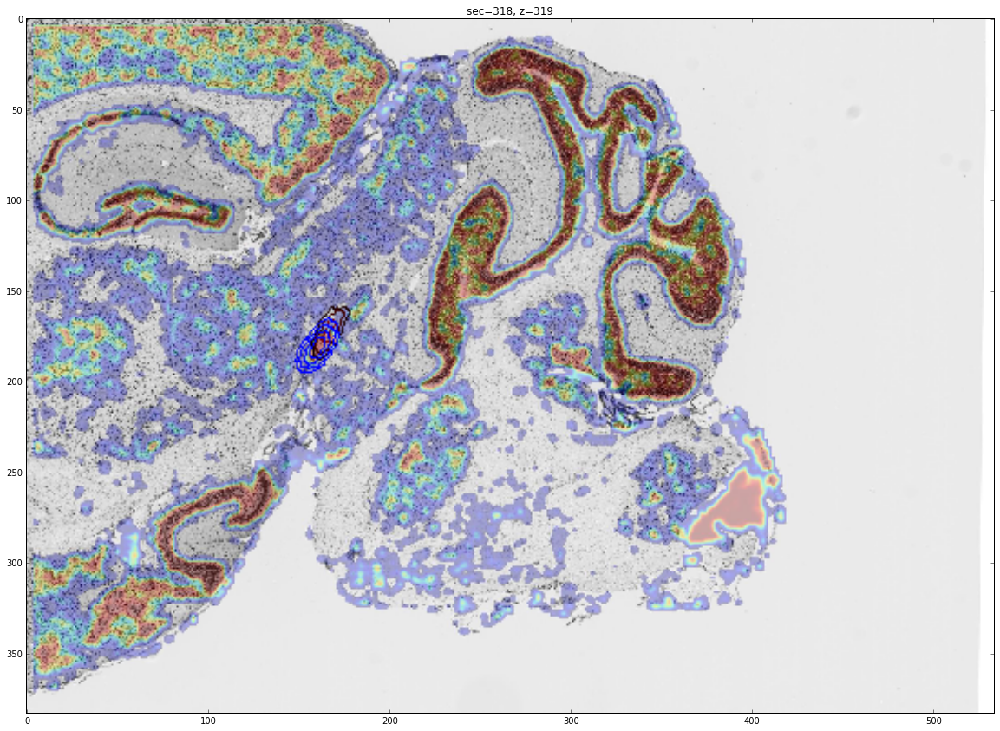

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC64-2015.08.25-18.30.40_MD593_2_0191_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC64-2015.08.25-18.30.40_MD593_2_0191_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC64-2015.08.25-18.30.40_MD593_2_0191_prep2_down8_PBG_detector15_scoremapViz.jpg"


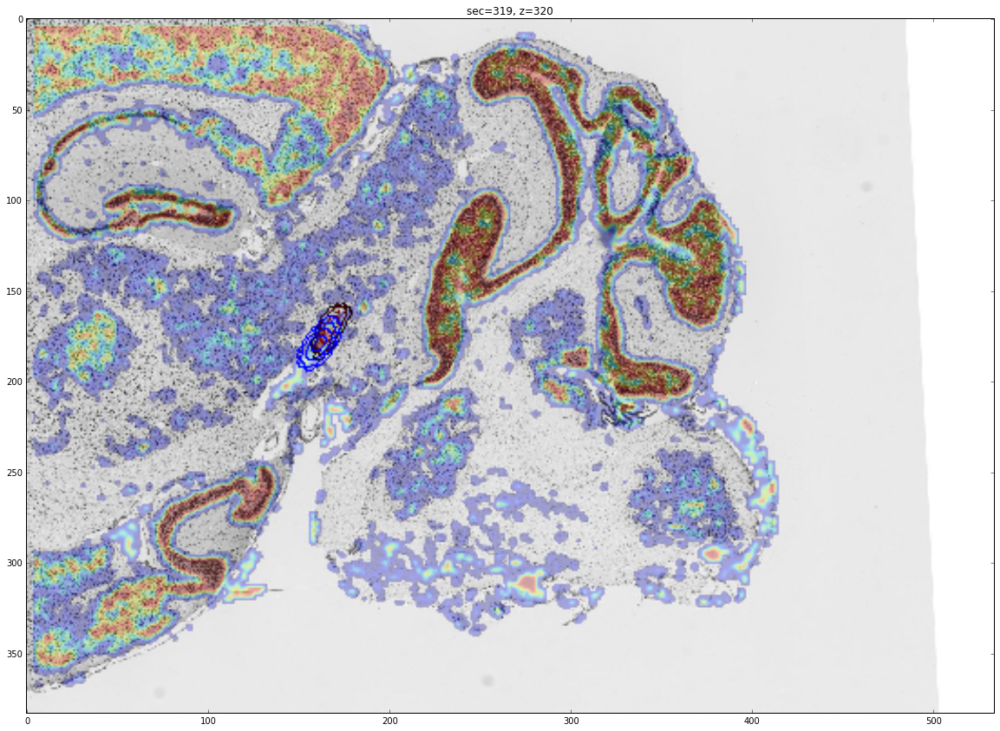

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N64-2015.08.21-21.38.56_MD593_3_0192_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N64-2015.08.21-21.38.56_MD593_3_0192_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N64-2015.08.21-21.38.56_MD593_3_0192_prep2_down8_PBG_detector15_scoremapViz.jpg"


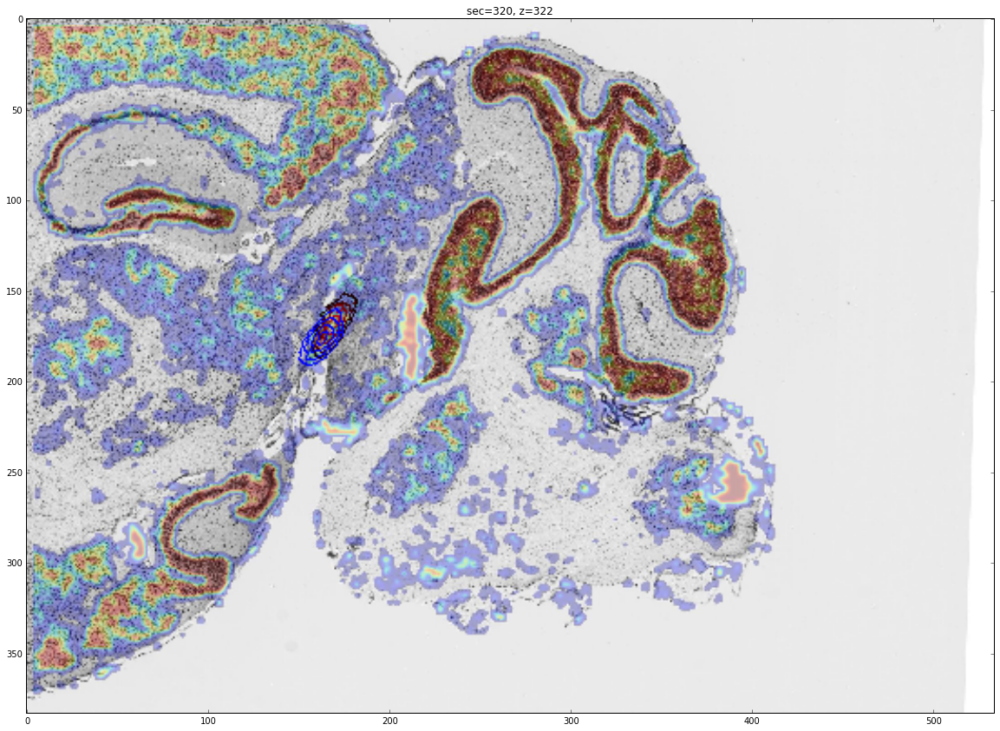

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC64-2015.08.25-18.30.40_MD593_1_0192_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC64-2015.08.25-18.30.40_MD593_1_0192_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC64-2015.08.25-18.30.40_MD593_1_0192_prep2_down8_PBG_detector15_scoremapViz.jpg"


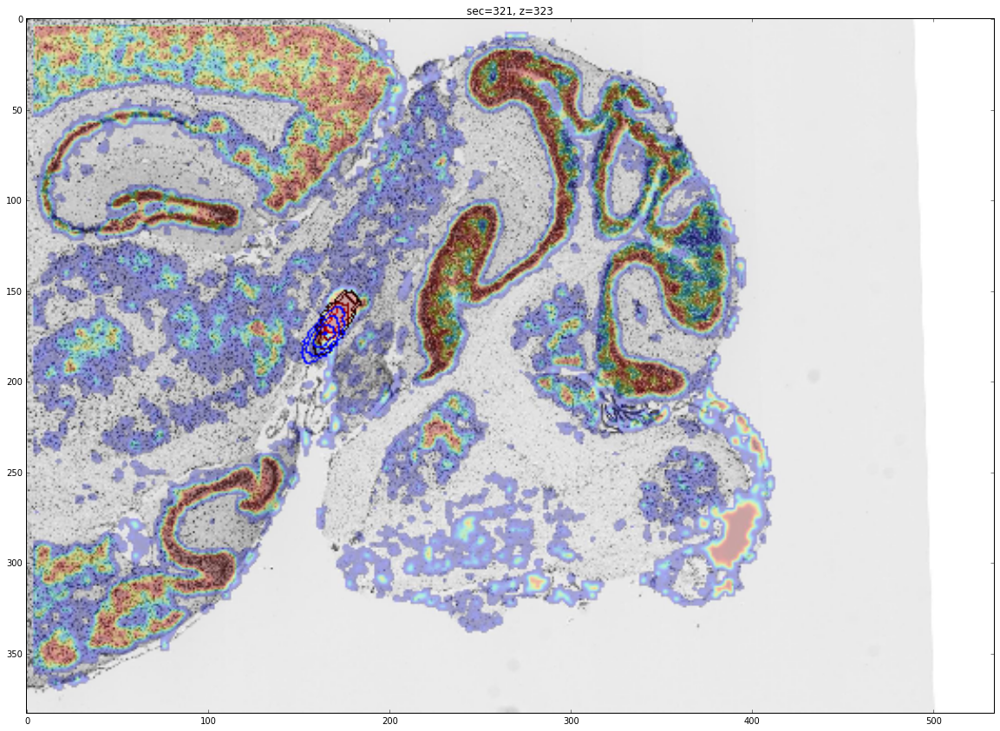

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N65-2015.08.21-21.43.42_MD593_1_0193_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N65-2015.08.21-21.43.42_MD593_1_0193_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N65-2015.08.21-21.43.42_MD593_1_0193_prep2_down8_PBG_detector15_scoremapViz.jpg"


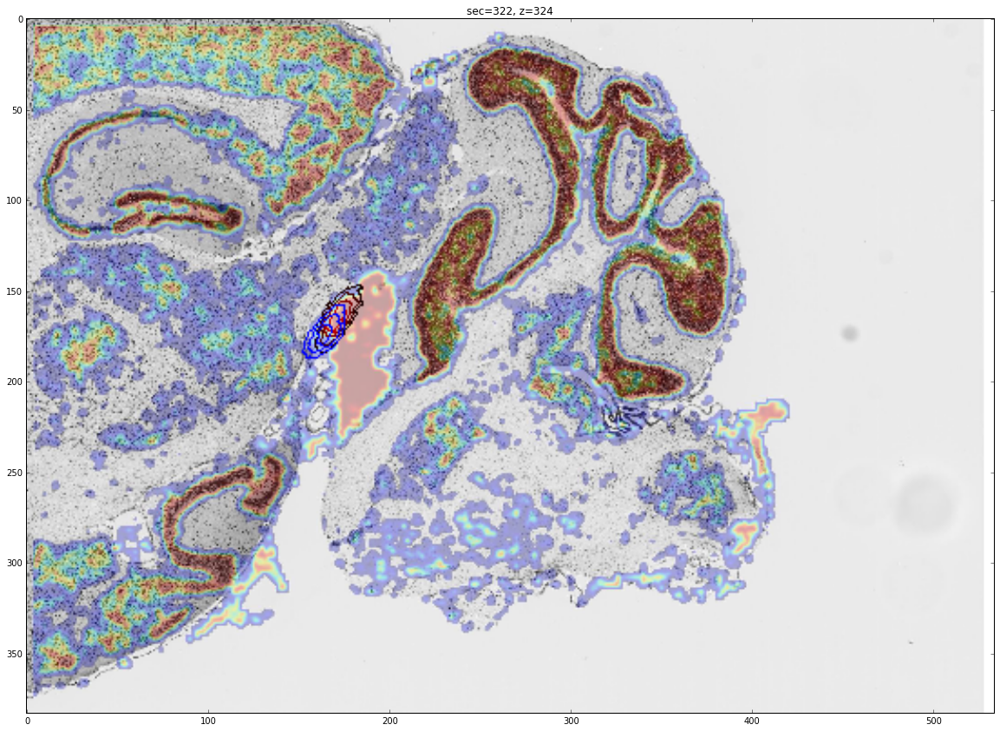

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC65-2015.08.25-18.35.54_MD593_1_0193_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC65-2015.08.25-18.35.54_MD593_1_0193_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC65-2015.08.25-18.35.54_MD593_1_0193_prep2_down8_PBG_detector15_scoremapViz.jpg"


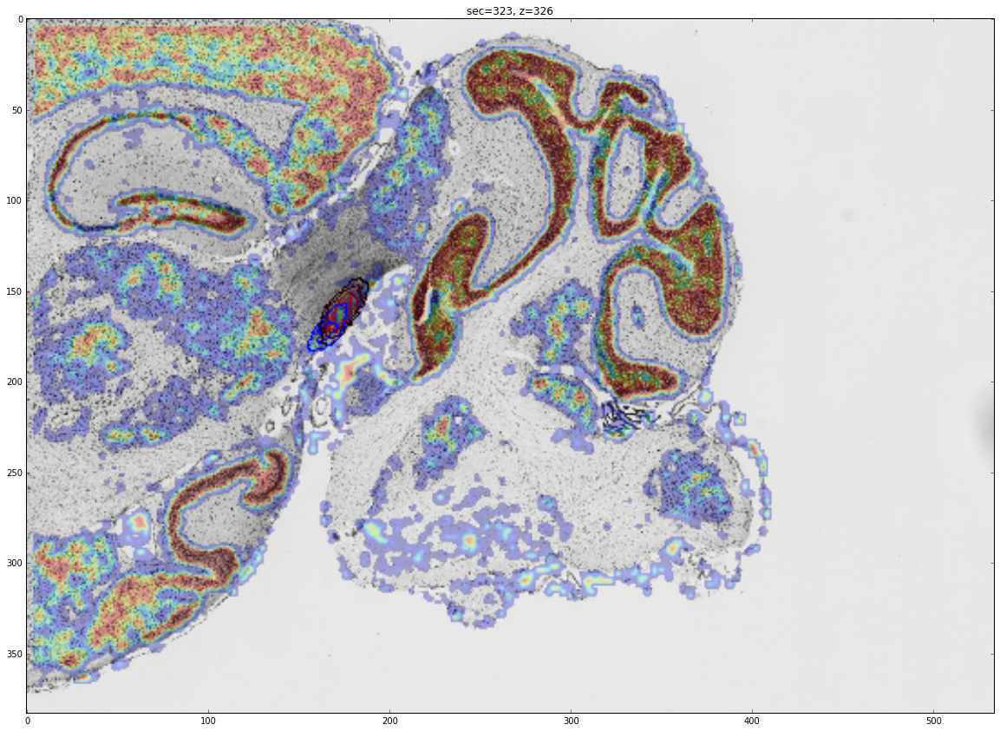

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N65-2015.08.21-21.43.42_MD593_2_0194_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N65-2015.08.21-21.43.42_MD593_2_0194_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N65-2015.08.21-21.43.42_MD593_2_0194_prep2_down8_PBG_detector15_scoremapViz.jpg"


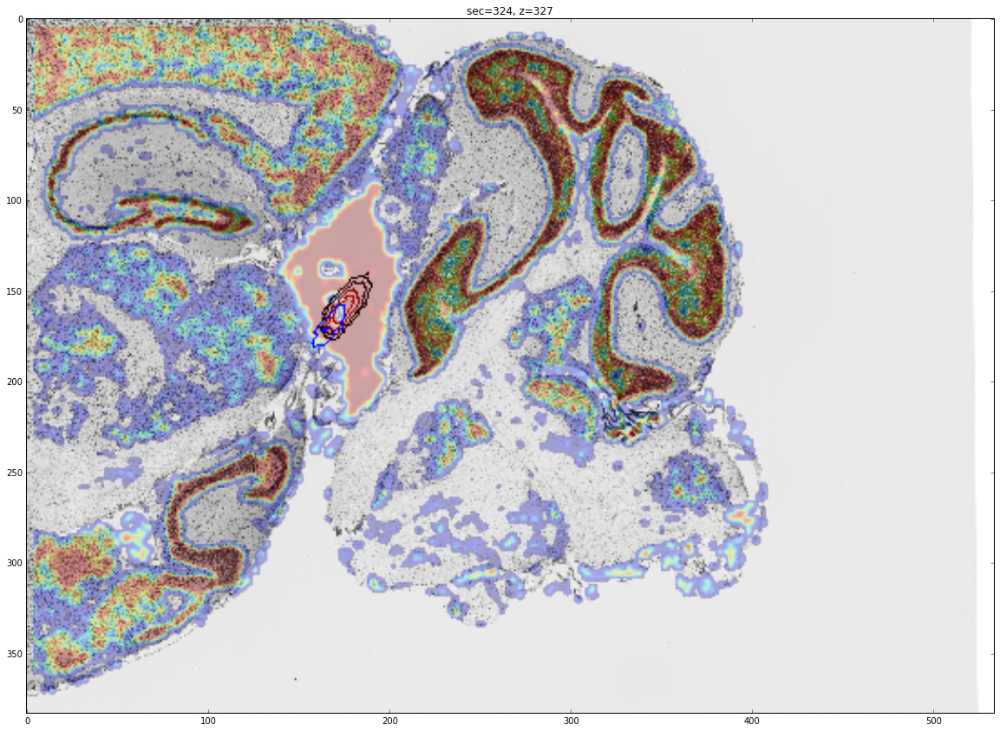

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC65-2015.08.25-18.35.54_MD593_2_0194_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC65-2015.08.25-18.35.54_MD593_2_0194_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC65-2015.08.25-18.35.54_MD593_2_0194_prep2_down8_PBG_detector15_scoremapViz.jpg"


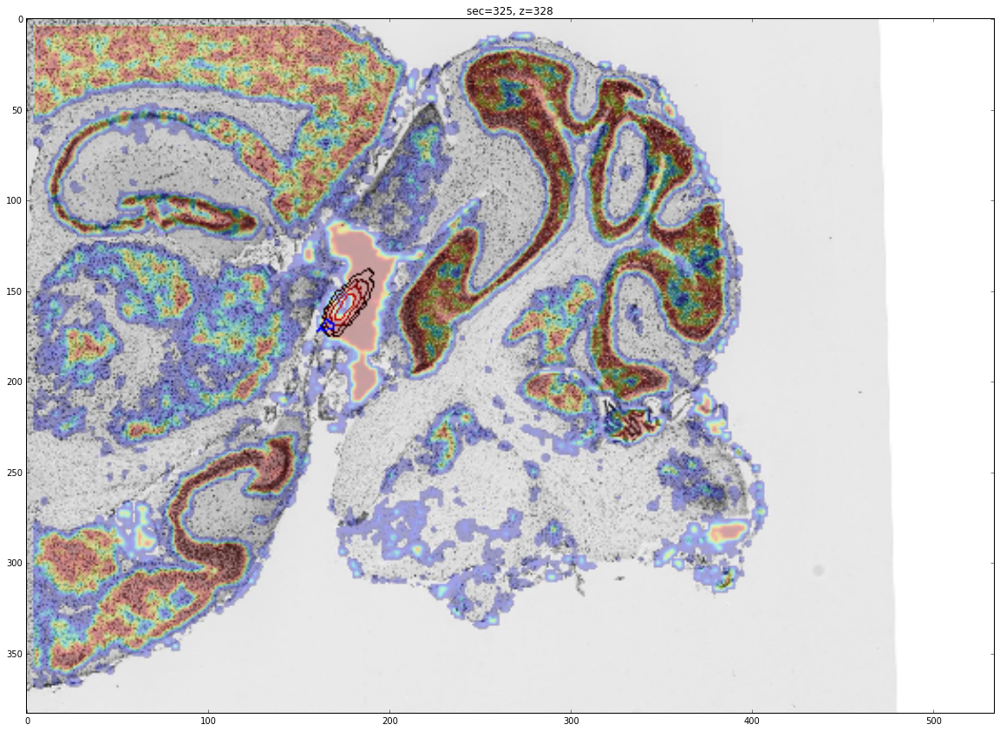

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N65-2015.08.21-21.43.42_MD593_3_0195_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N65-2015.08.21-21.43.42_MD593_3_0195_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N65-2015.08.21-21.43.42_MD593_3_0195_prep2_down8_PBG_detector15_scoremapViz.jpg"


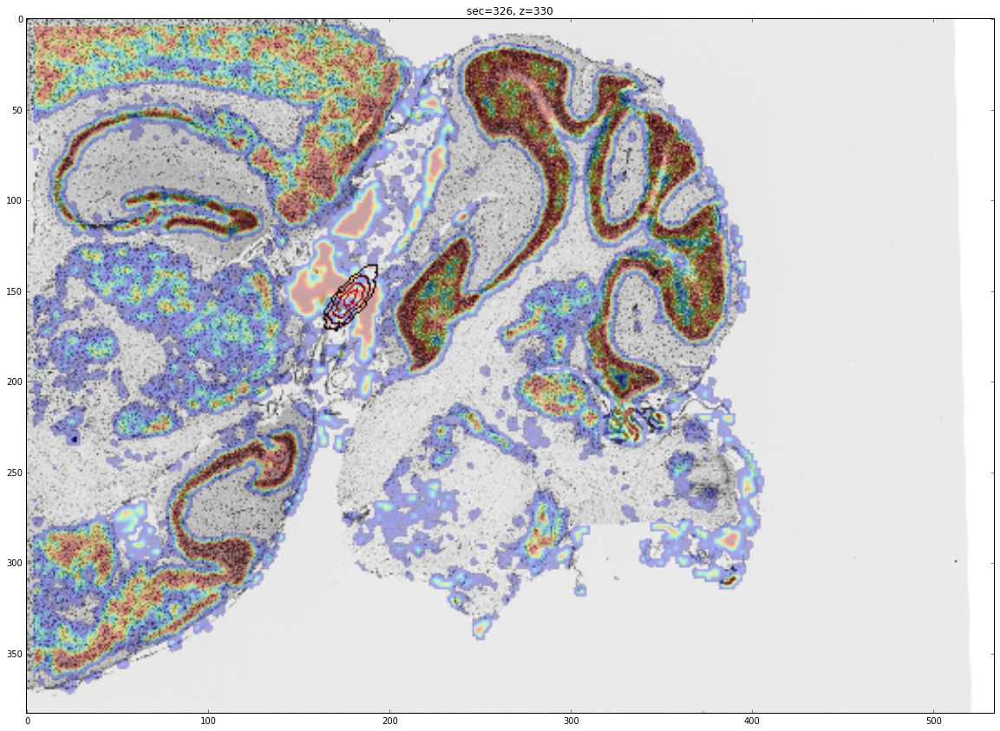

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC65-2015.08.25-18.35.54_MD593_3_0195_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC65-2015.08.25-18.35.54_MD593_3_0195_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC65-2015.08.25-18.35.54_MD593_3_0195_prep2_down8_PBG_detector15_scoremapViz.jpg"


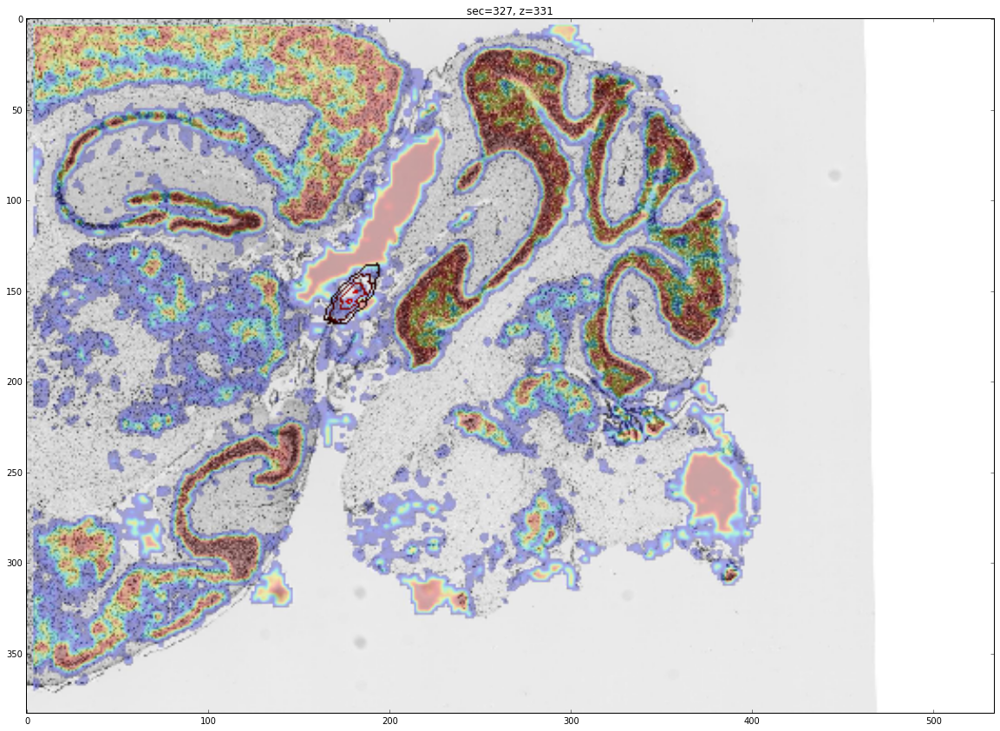

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC66-2015.08.25-18.40.38_MD593_3_0196_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC66-2015.08.25-18.40.38_MD593_3_0196_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC66-2015.08.25-18.40.38_MD593_3_0196_prep2_down8_PBG_detector15_scoremapViz.jpg"


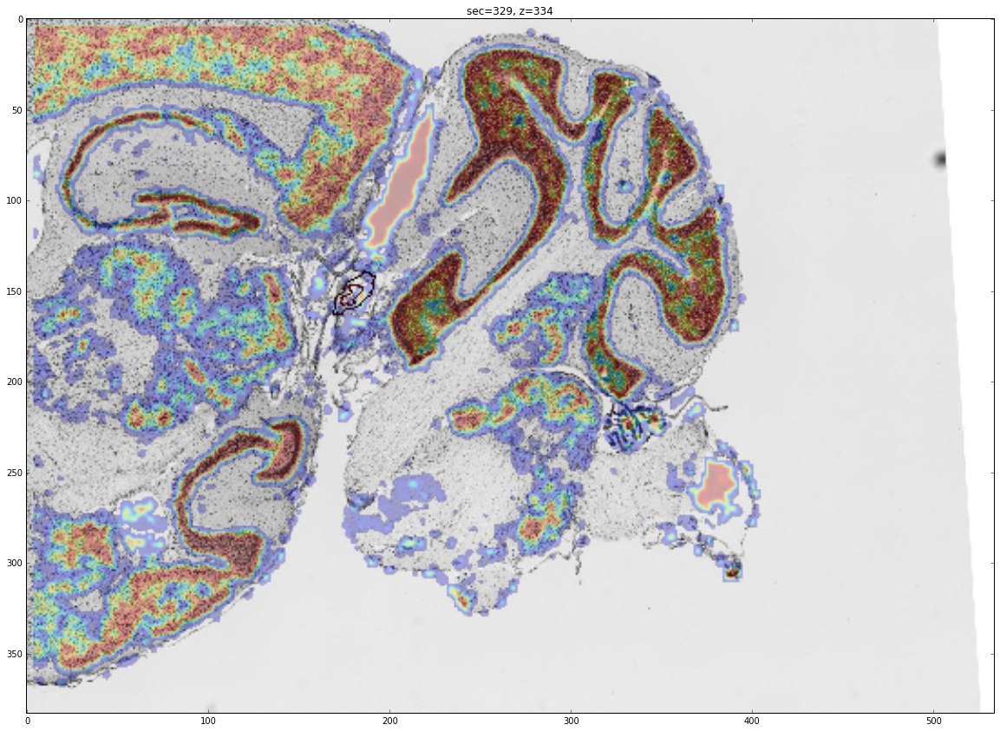

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N66-2015.08.21-21.48.27_MD593_2_0197_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N66-2015.08.21-21.48.27_MD593_2_0197_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-N66-2015.08.21-21.48.27_MD593_2_0197_prep2_down8_PBG_detector15_scoremapViz.jpg"


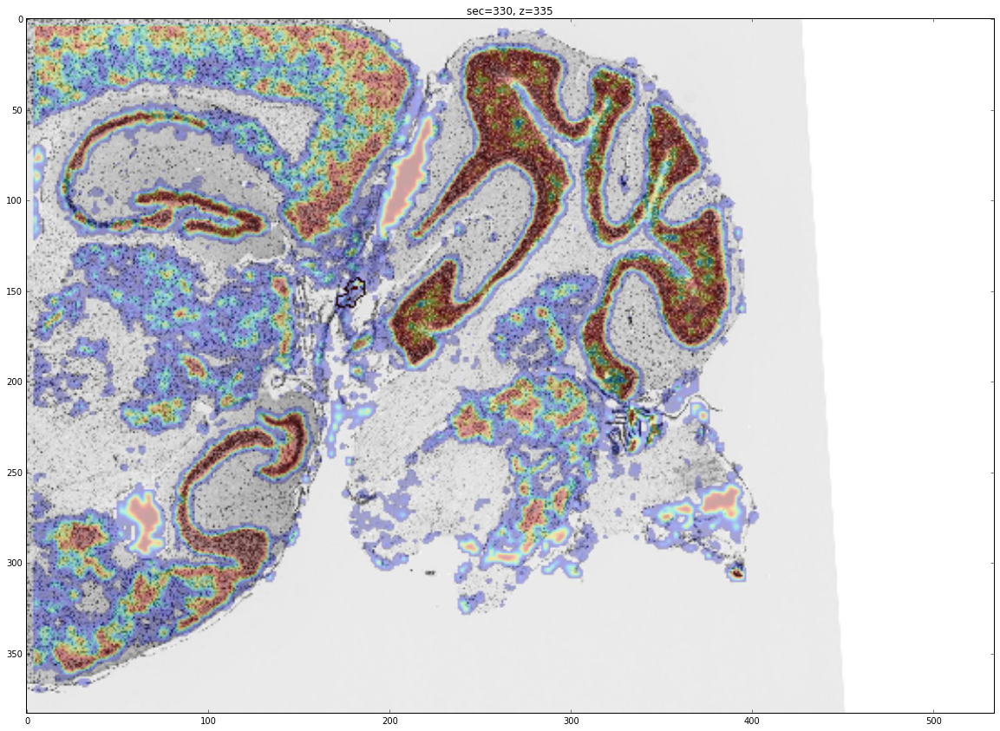

rm -rf "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC66-2015.08.25-18.40.38_MD593_2_0197_prep2_down8_PBG_detector15_scoremapViz.jpg" && mkdir -p "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC66-2015.08.25-18.40.38_MD593_2_0197_prep2_down8_PBG_detector15_scoremapViz.jpg" "/home/yuncong/CSHL_scoremap_viz/down8/PBG/MD593/detector15/prep2/MD593-IHC66-2015.08.25-18.40.38_MD593_2_0197_prep2_down8_PBG_detector15_scoremapViz.jpg"


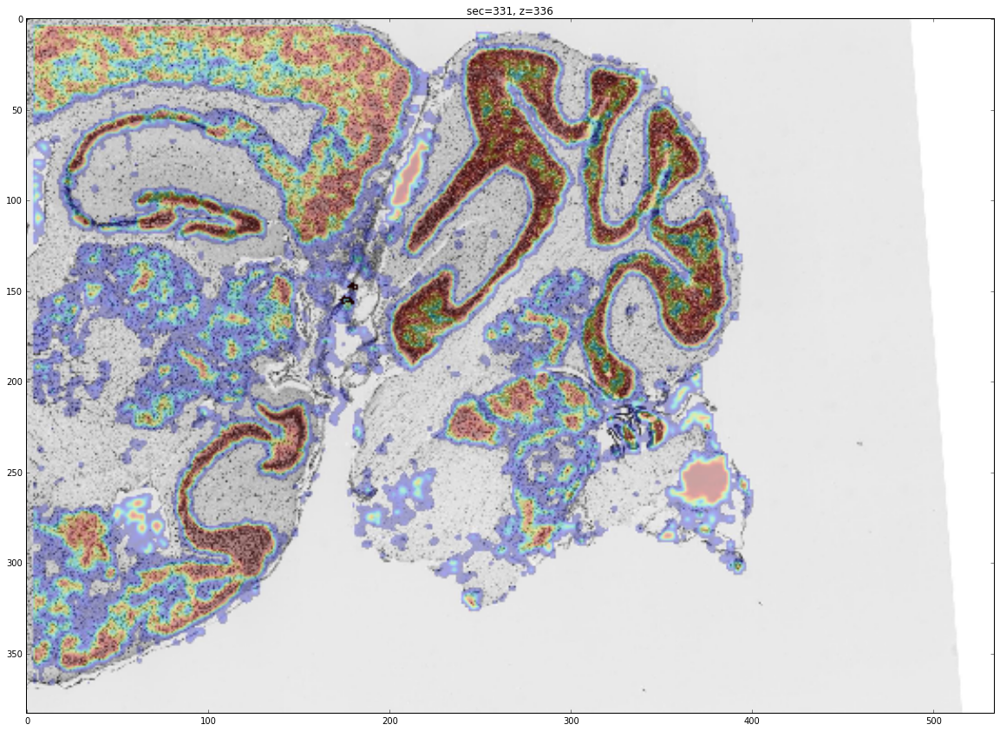

In [50]:
# Generate overlay visualization

# estimate mapping between z and section
# downsample_factor = 32
# xy_pixel_distance_downsampled = XY_PIXEL_DISTANCE_LOSSLESS * downsample_factor
# voxel_z_size = SECTION_THICKNESS / xy_pixel_distance_downsampled

# For getting correct contour location
xmin_vol_f, xmax_vol_f, ymin_vol_f, ymax_vol_f, zmin_vol_f, zmax_vol_f = \
DataManager.load_original_volume_bbox(stack=stack_fixed, volume_type='score', 
                                      prep_id=2, detector_id=detector_id,
                                      structure='7N', downscale=32)
print xmin_vol_f, xmax_vol_f, ymin_vol_f, ymax_vol_f, zmin_vol_f, zmax_vol_f

# Generate atlas overlay image for every section

zf, zl = bbox_3d(local_transformed_moving_structure_vol)[4:]
sec_first = DataManager.convert_z_to_section(stack=stack_fixed, z=zf, downsample=32)
sec_last = DataManager.convert_z_to_section(stack=stack_fixed, z=zl, downsample=32)

for sec in range(sec_first, sec_last+1):
# for sec in [181]:
    
    if is_invalid(stack=stack_fixed, sec=sec):
        continue
    
#     img_fn = DataManager.get_image_filepath(stack=stack_fixed, section=sec, resol='thumbnail', version='cropped_tif')
#     img = imread(img_fn)
    
    try:
#         img = DataManager.load_image(stack=stack_fixed, section=sec, resol='thumbnail', version='cropped_tif')
        sc_viz_fp = DataManager.get_scoremap_viz_filepath(stack=stack_fixed, section=sec, 
                                                           downscale=8,
                                                           structure=convert_to_original_name(structure), 
                                                           prep_id=2, detector_id=detector_id)
        download_from_s3(sc_viz_fp)
        img = imread(sc_viz_fp)[::4, ::4]
    except:
        sys.stderr.write('Error loading scoremap for section %d\n' % sec)
        continue
        
#     img = img[::4, ::4]
    
    viz = img.copy()
    
    z1, z2 = DataManager.convert_section_to_z(stack=stack_fixed, sec=sec, downsample=32)
    z = int(z1)
    
    # Find moving volume annotation contours
    c = 0
    vol = local_transformed_moving_structure_vol
    for level in levels:
        cnts = find_contours(vol[..., z], level=level) # rows, cols
        c += len(cnts)
        for cnt in cnts:
            # r,c to x,y
            cnt_on_cropped = cnt[:,::-1] + (xmin_vol_f, ymin_vol_f)
            cv2.polylines(viz, [cnt_on_cropped.astype(np.int)], True, level_colors[level], 1)
    
#     if c > 0:    
#         plt.figure(figsize=(20, 20));
#         plt.title("sec=%d, z=%d" % (sec, z));
#         plt.imshow(viz);
#         plt.show();
    
    ############################
    
    # Find moving volume annotation contours
#     c = 0
    vol = global_transformed_moving_structure_vol
    for level in levels:
        cnts = find_contours(vol[..., z], level=level) # rows, cols
        c += len(cnts)
        for cnt in cnts:
            # r,c to x,y
            cnt_on_cropped = cnt[:,::-1] + (xmin_vol_f, ymin_vol_f)
            cv2.polylines(viz, [cnt_on_cropped.astype(np.int)], True, (0,0,255), 1)
    
    if c > 0:    
        plt.figure(figsize=(20, 20));
        plt.title("sec=%d, z=%d" % (sec, z));
        plt.imshow(viz);
        plt.show();
    
    
#     viz_fp = DataManager.get_alignment_viz_filepath(stack_m=stack_moving,
#                                             stack_f=stack_fixed,
#                                             classifier_setting_m=classifier_setting,
#                                             classifier_setting_f=classifier_setting,
#                                             warp_setting=warp_setting,
#                                           section=sec)
    
#     create_if_not_exists(os.path.dirname(viz_fp))
#     imsave(viz_fp, viz)

In [191]:
display_image(viz)

/shared/MouseBrainAtlas/registration/tmp.jpg